##### Carnd-Vehicle-Detection

###  In this project, the goal is to write a software pipeline to identify vehicles in a video from a front-facing camera on a car. 

### v5:look a frame 680 to 735

In [1]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import argparse
import cv2
import os
import glob
import time
import pickle
from sklearn.svm import LinearSVC, SVC
from sklearn.preprocessing import StandardScaler
from skimage.feature import hog
from sklearn.model_selection import train_test_split
from mpl_toolkits.mplot3d import Axes3D

## Load Training Data

8792
8968
Example Images..


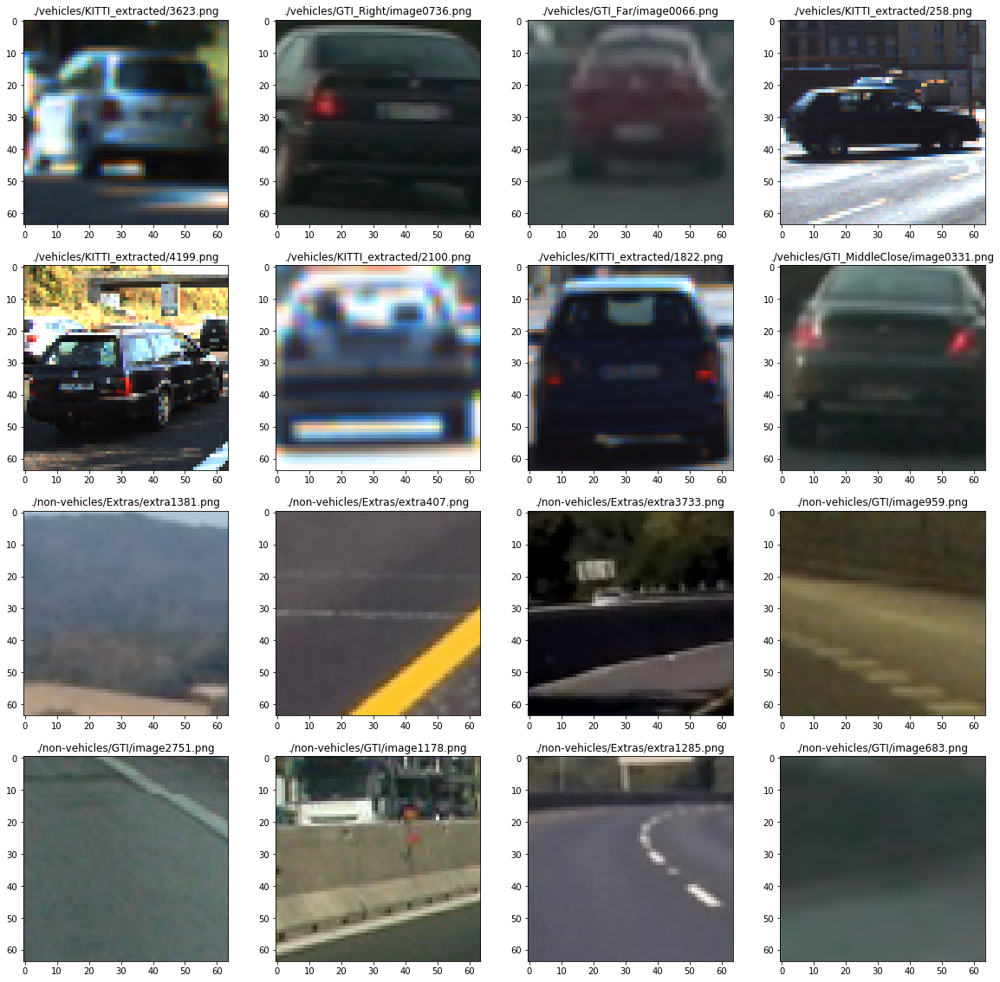

In [2]:
savefigs = False 

import random
# Load Training Data for car, non-car classification
# The file names of the training images
car_files = glob.glob('./vehicles/*/*.png')
noncar_files = glob.glob('./non-vehicles/*/*.png')
# The training images
car_images = []
noncar_images = []
for image in car_files:
     car_images.append(image)
for image in noncar_files:
    noncar_images.append(image)
car_num = len(car_images)
noncar_num = len(noncar_images)
print(car_num)
print(noncar_num)

print("Example Images..")    
# Randomly show example images from cars, and non-cars
example_N_fromEachClass = 8
fig = plt.figure(figsize=(20, 20))
for i in range(0,example_N_fromEachClass):
    # car 
    plt.subplot(4,4,i+1)
    imgfile  = car_images[random.randint (0, car_num -1)]
    img = mpimg.imread(imgfile)
    plt.imshow(img) 
    plt.title(imgfile)
    # non-car
    plt.subplot(4,4,i+ example_N_fromEachClass +1)
    imgfile  = noncar_images[random.randint (0, noncar_num -1)]
    img = mpimg.imread(imgfile)
    plt.imshow(img) 
    plt.title(imgfile)    
plt.show()


## Feature Extraction
###  Color Histogram,  Color Spatial Binning & Histogram of Oriented Gradients (HOG)

In [3]:
# Lesson Funcctions  -  Codes in this cell are adapted from CarND Class for Vehicle Classifier
# Define a function to convert an image from one color space to another color space
def convert_color(img, conv='RGB2YCrCb'):
    if conv == 'RGB2BGR':
        return cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    if conv == 'RGB2YCrCb':
        return cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    if conv == 'RGB2LUV':
        return cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
    if conv == 'BGR2LUV':
        return cv2.cvtColor(img, cv2.COLOR_BGR2LUV)
    if conv == 'RGB2YUV':
        return cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
    if conv == 'RGB2HLS':
        return cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

def bin_spatial(img, size=(32, 32)):
    # Convert image to new color space (if specified)
    # Use cv2.resize().ravel() to create the feature vector
    features = cv2.resize(img, size).ravel() 
    # Return the feature vector
    return features

def color_hist(img, nbins=32):
    # Compute the histogram of the color channels separately
    channel1_hist = np.histogram(img[:,:,0], bins=nbins, range=(0, 256))
    channel2_hist = np.histogram(img[:,:,1], bins=nbins, range=(0, 256))
    channel3_hist = np.histogram(img[:,:,2], bins=nbins, range=(0, 256))
    hist_features = np.concatenate((channel1_hist[0], channel2_hist[0], channel3_hist[0]))
    # Return the individual histograms, bin_centers and feature vector
    return hist_features


# Define a function to return HOG features and visualization
def get_hog_features(img, orient, pix_per_cell, cell_per_block, vis=False, feature_vec=True):
    if vis == True:
        features, hog_image = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=False, 
                                  visualise=True, feature_vector=False)
        return features, hog_image
    else:      
        features = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=False, 
                       visualise=False, feature_vector=feature_vec)
        return features  

    
# study the distribution of color values in an image by plotting each pixel in some color space.
# Here's a code snippet to generate 3D plots:
def plot3d(pixels, colors_rgb, axis_labels=list("RGB"), axis_limits=((0, 255), (0, 255), (0, 255))):
    """Plot pixels in 3D."""

    # Create figure and 3D axes
    fig = plt.figure(figsize=(8, 8))
    ax = Axes3D(fig)

    # Set axis limits
    ax.set_xlim(*axis_limits[0])
    ax.set_ylim(*axis_limits[1])
    ax.set_zlim(*axis_limits[2])

    # Set axis labels and sizes
    ax.tick_params(axis='both', which='major', labelsize=14, pad=8)
    ax.set_xlabel(axis_labels[0], fontsize=16, labelpad=16)
    ax.set_ylabel(axis_labels[1], fontsize=16, labelpad=16)
    ax.set_zlabel(axis_labels[2], fontsize=16, labelpad=16)

    # Plot pixel values with colors given in colors_rgb
    ax.scatter(
        pixels[:, :, 0].ravel(),
        pixels[:, :, 1].ravel(),
        pixels[:, :, 2].ravel(),
        c=colors_rgb.reshape((-1, 3)), edgecolors='none')

    return ax  # return Axes3D object for further manipulation

## Test hog features

/home/qliu/anaconda3/lib/python3.6/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


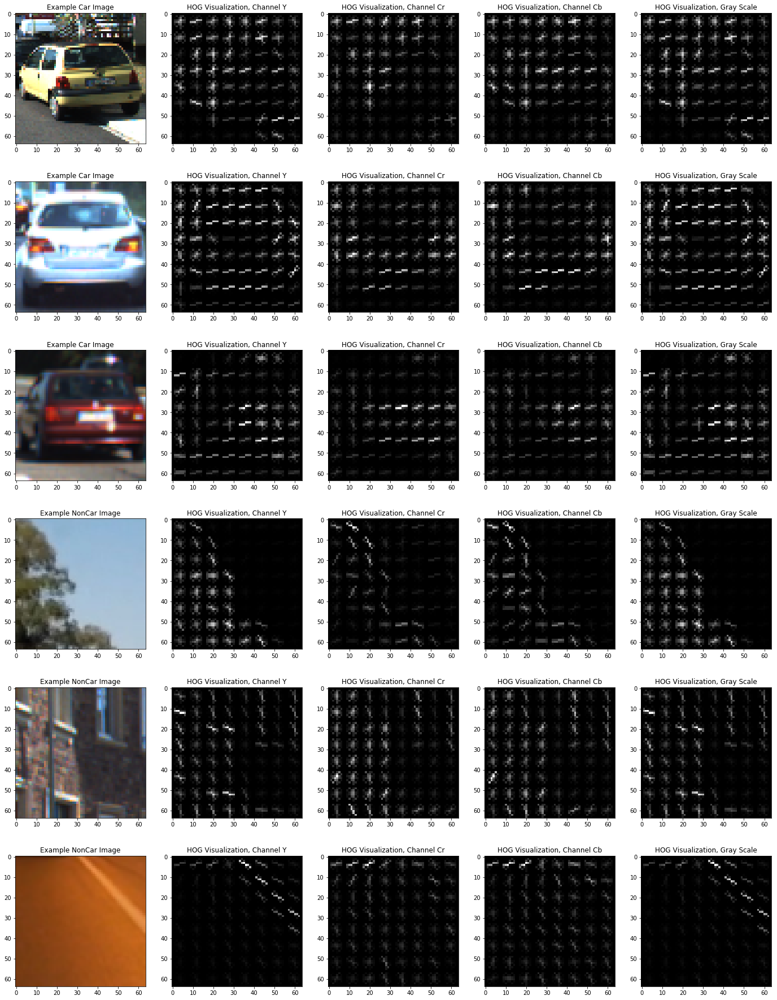

In [4]:
# Test hog features
folder = "./test_images_carNoncar/"
cars=["25.png", "31.png", "53.png"]
noncars  = ["2.png", "3.png", "8.png"]
# color space for hog features
conv ='RGB2YCrCb'
colors =['Y','Cr','Cb']
# Define HOG parameters
orient = 9
pix_per_cell = 8
cell_per_block = 2
# HOG Features for sample cars images
fig = plt.figure(figsize=(24,32))
for i in range(len(cars)): 
    img0 = mpimg.imread(folder+cars[i])
    img = convert_color(img0, conv = conv) 
    plt.subplot(6,5,5*i+1)
    plt.imshow(img0)
    plt.title('Example Car Image')    
    for c in range(3):     
        # Call our function with vis=True to see an image output
        features, hog_image = get_hog_features(img[:,:,c], orient, pix_per_cell, cell_per_block, 
                              vis=True, feature_vec=False)
        plt.subplot(6,5,5*i+1+c+1)
        plt.imshow(hog_image, cmap='gray')
        plt.title('HOG Visualization, Channel '+ colors[c])
    
    # Test gray scale
    features, hog_image = get_hog_features(cv2.cvtColor(img0, cv2.COLOR_RGB2GRAY), orient, pix_per_cell, cell_per_block, 
                          vis=True, feature_vec=False)       
    plt.subplot(6,5,5*i+1+c+1+1)
    plt.imshow(hog_image, cmap='gray')
    plt.title('HOG Visualization, Gray Scale')        
# HOG Features for sample noncars images
for i in range(len(noncars)): 
    img0 = mpimg.imread(folder+noncars[i])
    img = convert_color(img0, conv = conv) 
    plt.subplot(6,5,15+5*i+1)
    plt.imshow(img0)
    plt.title('Example NonCar Image')
    
    for c in range(3):     
        # Call our function with vis=True to see an image output
        features, hog_image = get_hog_features(img[:,:,c], orient, pix_per_cell, cell_per_block, 
                           vis=True, feature_vec=False)       
        plt.subplot(6,5,15+5*i+1+c+1)
        plt.imshow(hog_image, cmap='gray')
        plt.title('HOG Visualization, Channel '+ colors[c])
        
    # Gray scale
    features, hog_image = get_hog_features(cv2.cvtColor(img0, cv2.COLOR_RGB2GRAY), orient, pix_per_cell, cell_per_block, 
                           vis=True, feature_vec=False)     
    plt.subplot(6,5,15+5*i+1+c+1+1)
    plt.imshow(hog_image, cmap='gray')
    plt.title('HOG Visualization, Gray Scale')    
plt.show()   



## Combine Features 

In [5]:
### Codes in this cell are adapted from CarND Class for Vehicle Classifier
def single_img_features(image, color_space='RGB', spatial_size=(32, 32),
                     hist_bins=32, orient=9,
                     pix_per_cell=8, cell_per_block=2, hog_channel=0,
                     spatial_feat=True, hist_feat=True, hog_feat=True):
    # apply color conversion if other than 'BGR' from cv2
    if color_space != 'RGB':
        if color_space == 'HSV':
            feature_image = convert_color(image, conv='RGB2HSV')        
        elif color_space == 'LUV':
            feature_image = convert_color(image, conv='RGB2LUV')
        elif color_space == 'HLS':
            feature_image = convert_color(image, conv='RGB2HLS')
        elif color_space == 'YUV':
            feature_image = convert_color(image, conv='RGB2YUV')
        elif color_space == 'YCrCb':
            feature_image = convert_color(image, conv='RGB2YCrCb')
    else:
        feature_image = np.copy(image)

    file_features = []
    if spatial_feat == True:
        spatial_features = bin_spatial(feature_image, size=spatial_size)
        file_features.append(spatial_features)
    if hist_feat == True:
        # Apply color_hist()
        hist_features = color_hist(feature_image, nbins=hist_bins)
        file_features.append(hist_features)
    if hog_feat == True:
        # Call get_hog_features() with vis=False, feature_vec=True
        if hog_channel == 'ALL':
            hog_features = []
            for channel in range(feature_image.shape[2]):
                hog_features.append(get_hog_features(feature_image[:, :, channel],
                                                     orient, pix_per_cell, cell_per_block,
                                                     vis=False, feature_vec=True))
            hog_features = np.ravel(hog_features)
        else:
            hog_features = get_hog_features(feature_image[:, :, hog_channel], orient,
                                            pix_per_cell, cell_per_block, vis=False, feature_vec=True)
        # Append the new feature vector to the features list
        file_features.append(hog_features)
    return np.concatenate(file_features)

# Define a function to extract features from a list of images
def extract_features(imgs, color_space='RGB', spatial_size=(32, 32),
                        hist_bins=32, orient=9, 
                        pix_per_cell=8, cell_per_block=2, hog_channel=0,
                        spatial_feat=True, hist_feat=True, hog_feat=True):
    # Create a list to append feature vectors to
    features = []
  
    # Iterate through the list of images
    for file in imgs:
        file_features = []   
        # Read in each one by one
        image = mpimg.imread(file)[:,:,:3]
        file_features = single_img_features(image, color_space=color_space, spatial_size = spatial_size,
                            hist_bins=hist_bins, orient=orient,
                            pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                            spatial_feat=spatial_feat, hist_feat=hist_feat, hog_feat=hog_feat)
        features.append(file_features)
   
    # Return list of feature vectors
    return features

## Build a Classifier

In [7]:
# Combine and Normalize Features
spatial_feat = True
hist_feat = True
hog_feat = True
# color space 
color_space = 'YCrCb'
# HOG parameters
# HOG channel
hog_channel = 'ALL'
# HOG orientations
orient = 9
# HOG pix_per_cell
pix_per_cell = 8
# HOG cell_per_block
cell_per_block = 2
# color histogram bin number
hist_bins = 16
# Bin spatial size
spatial_size=(16, 16)

# Feature Extraction         
car_features = extract_features(car_files, color_space=color_space, spatial_size=spatial_size, 
                        hist_bins = hist_bins,orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel, 
                        spatial_feat=spatial_feat, hist_feat=hist_feat, hog_feat=hog_feat)
noncar_features = extract_features(noncar_files, color_space=color_space, spatial_size=spatial_size, 
                        hist_bins = hist_bins,orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel, 
                        spatial_feat=spatial_feat, hist_feat=hist_feat, hog_feat=hog_feat)
print(len(car_features))
print(len(noncar_features))

# Create an array stack of feature vectors
X = np.vstack((car_features, noncar_features)).astype(np.float64)                        
# Fit a per-column scaler
X_scaler = StandardScaler().fit(X)
# Apply the scaler to X
scaled_X = X_scaler.transform(X)

# Define the labels vector
y = np.hstack((np.ones(len(car_features)), np.zeros(len(noncar_features))))

# Split up data into randomized training and test sets
rand_state = np.random.randint(0, 100)
X_train, X_test, y_train, y_test = train_test_split(
    scaled_X, y, test_size=0.2, random_state=rand_state)
print('Size of Training Data:', X_train.shape)
print('Size of Test Data:', X_test.shape)

# SVC linear clasifier
svc = LinearSVC() # Use a linear SVC 
# RBF support vector machine classifiers
# svc = SVC(C=100, gamma=0.05)
print('training svc...')
t=time.time()
svc.fit(X_train, y_train) # Train the classifier
t2 = time.time()
print(round(t2-t, 2), 'Seconds to train SVC...')
print('Test Accuracy of SVC = ', round(svc.score(X_test, y_test), 4)) # Check the score of the SVC

/home/qliu/anaconda3/lib/python3.6/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


8792
8968
Size of Training Data: (14208, 6108)
Size of Test Data: (3552, 6108)
training svc...
12.03 Seconds to train SVC...
Test Accuracy of SVC =  0.9856


## Slide Window Search 

In [8]:
### Codes in this cell are adapted from CarND Class for Vehicle Classifier
# Define a function that takes an image,
# start and stop positions in both x and y, 
# window size (x and y dimensions),  
# and overlap fraction (for both x and y)
def slide_window(img, x_start_stop=[None, None], y_start_stop=[None, None], 
                    xy_window=(64, 64), xy_overlap=(0.5, 0.5)):
    # If x and/or y start/stop positions not defined, set to image size
    if x_start_stop[0] == None:
        x_start_stop[0] = 0
    if x_start_stop[1] == None:
        x_start_stop[1] = img.shape[1]
    if y_start_stop[0] == None:
        y_start_stop[0] = 0
    if y_start_stop[1] == None:
        y_start_stop[1] = img.shape[0]
    # Compute the span of the region to be searched    
    xspan = x_start_stop[1] - x_start_stop[0]
    yspan = y_start_stop[1] - y_start_stop[0]
    # Compute the number of pixels per step in x/y
    nx_pix_per_step = np.int(xy_window[0]*(1 - xy_overlap[0]))
    ny_pix_per_step = np.int(xy_window[1]*(1 - xy_overlap[1]))
    # Compute the number of windows in x/y
    nx_buffer = np.int(xy_window[0]*(xy_overlap[0]))
    ny_buffer = np.int(xy_window[1]*(xy_overlap[1]))
    nx_windows = np.int((xspan-nx_buffer)/nx_pix_per_step) 
    ny_windows = np.int((yspan-ny_buffer)/ny_pix_per_step) 
    # Initialize a list to append window positions to
    window_list = []
    # Loop through finding x and y window positions
    # Note: you could vectorize this step, but in practice
    # you'll be considering windows one by one with your
    # classifier, so looping makes sense
    for ys in range(ny_windows):
        for xs in range(nx_windows):
            # Calculate window position
            startx = xs*nx_pix_per_step + x_start_stop[0]
            endx = startx + xy_window[0]
            starty = ys*ny_pix_per_step + y_start_stop[0]
            endy = starty + xy_window[1]
            # Append window position to list
            window_list.append(((startx, starty), (endx, endy)))
    # Return the list of windows
    return window_list

# Define a function you will pass an image 
# and the list of windows to be searched (output of slide_windows())
def search_windows(img, windows, clf, scaler, color_space='RGB', 
                    spatial_size=(32, 32), hist_bins=32, 
                    hist_range=(0, 256), orient=9, 
                    pix_per_cell=8, cell_per_block=2, 
                    hog_channel=0, spatial_feat=True, 
                    hist_feat=True, hog_feat=True):

    #1) Create an empty list to receive positive detection windows
    on_windows = []
    #2) Iterate over all windows in the list
    for window in windows:
        #3) Extract the test window from original image
        test_img = cv2.resize(img[window[0][1]:window[1][1], window[0][0]:window[1][0]], (64, 64))      
        #4) Extract features for that window using single_img_features()
        features = single_img_features(test_img, color_space=color_space, 
                            spatial_size=spatial_size, hist_bins=hist_bins, 
                            orient=orient, pix_per_cell=pix_per_cell, 
                            cell_per_block=cell_per_block, 
                            hog_channel=hog_channel, spatial_feat=spatial_feat, 
                            hist_feat=hist_feat, hog_feat=hog_feat)
        #5) Scale extracted features to be fed to classifier
        test_features = scaler.transform(np.array(features).reshape(1, -1))
        #6) Predict using your classifier
        prediction = clf.predict(test_features)
        #7) If positive (prediction == 1) then save the window
        if prediction == 1:
            on_windows.append(window)
    #8) Return windows for positive detections
    return on_windows

def draw_boxes(img, bboxes, color=(0, 0, 255), thick=6):
    # Make a copy of the image
    imcopy = np.copy(img)
    # Iterate through the bounding boxes
    for bbox in bboxes:
        # Draw a rectangle given bbox coordinates
        cv2.rectangle(imcopy, bbox[0], bbox[1], color, thick)
    # Return the image copy with boxes drawn
    return imcopy

## Test Slide Window Search

/home/qliu/anaconda3/lib/python3.6/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


test_images/test1.jpg


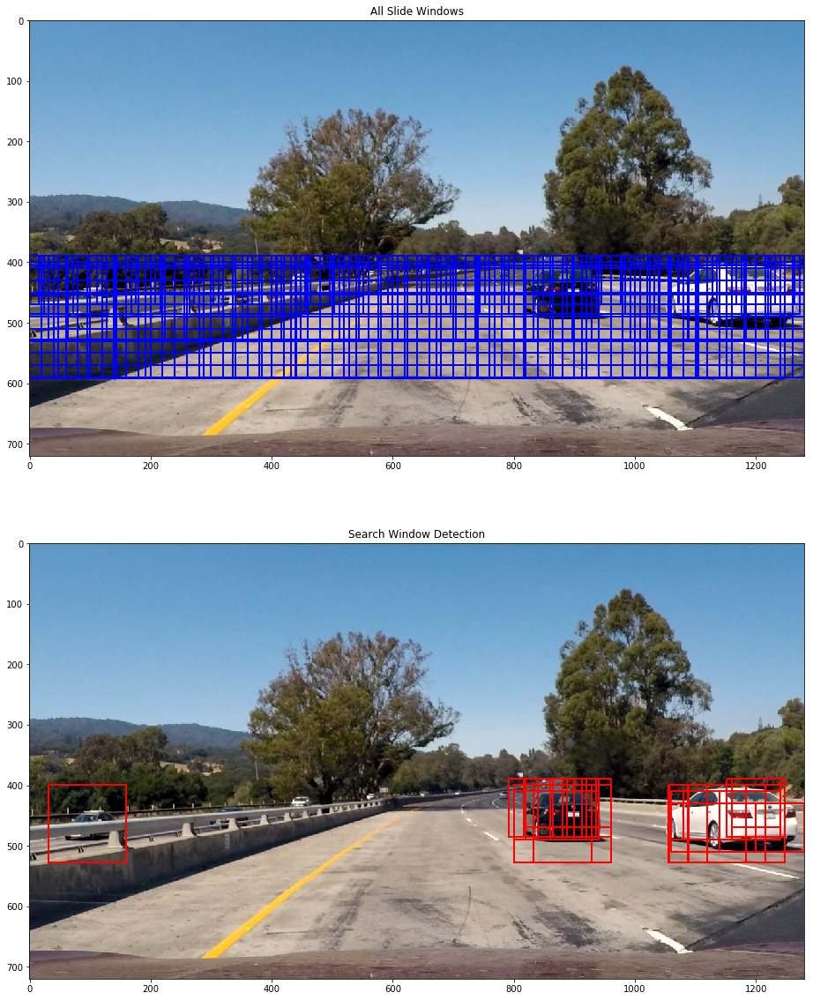

test1.jpg
test_images/test2.jpg


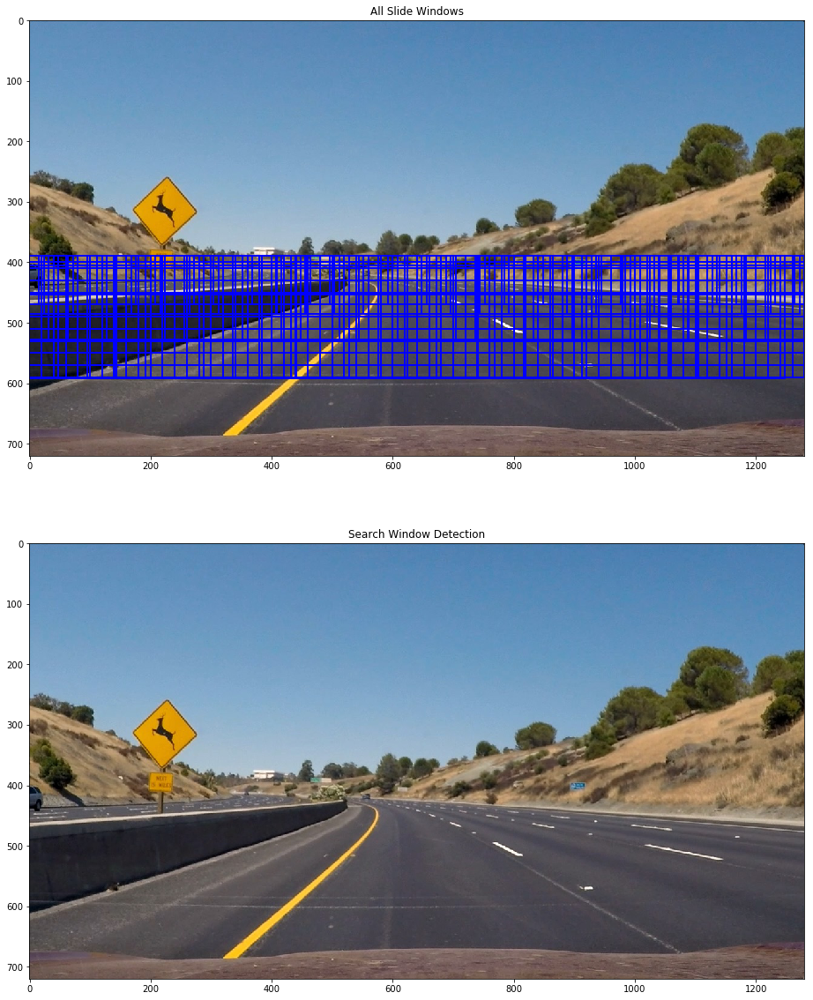

test2.jpg
test_images/test3.jpg


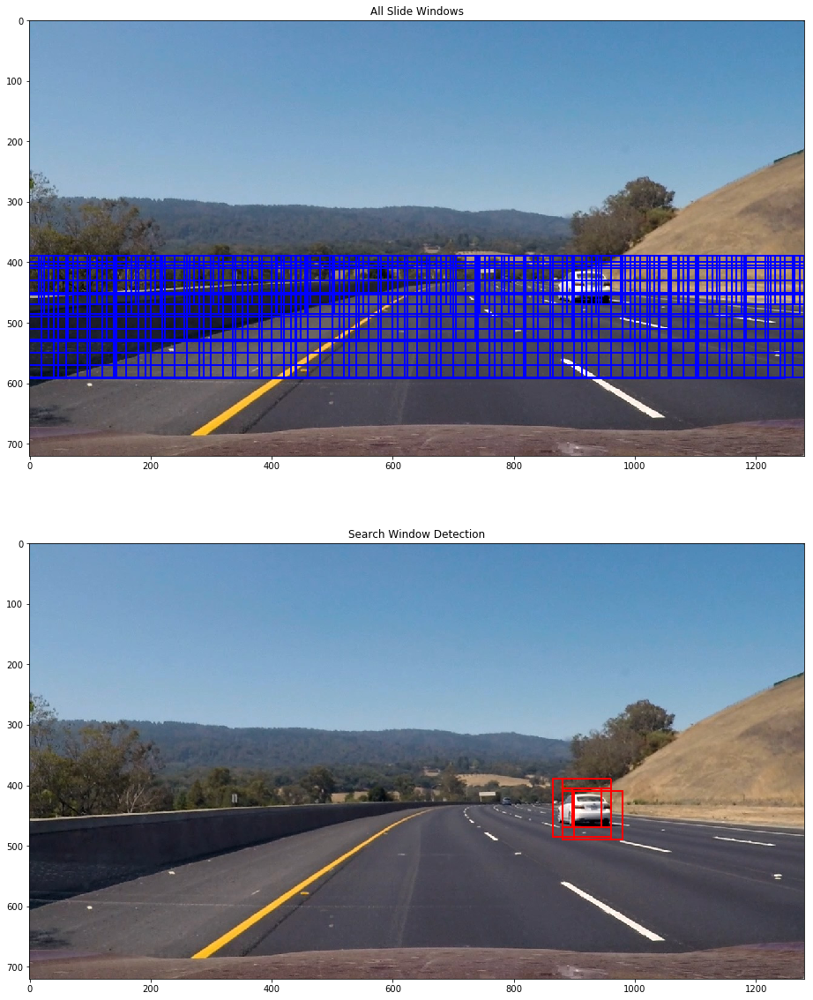

test3.jpg
test_images/test4.jpg


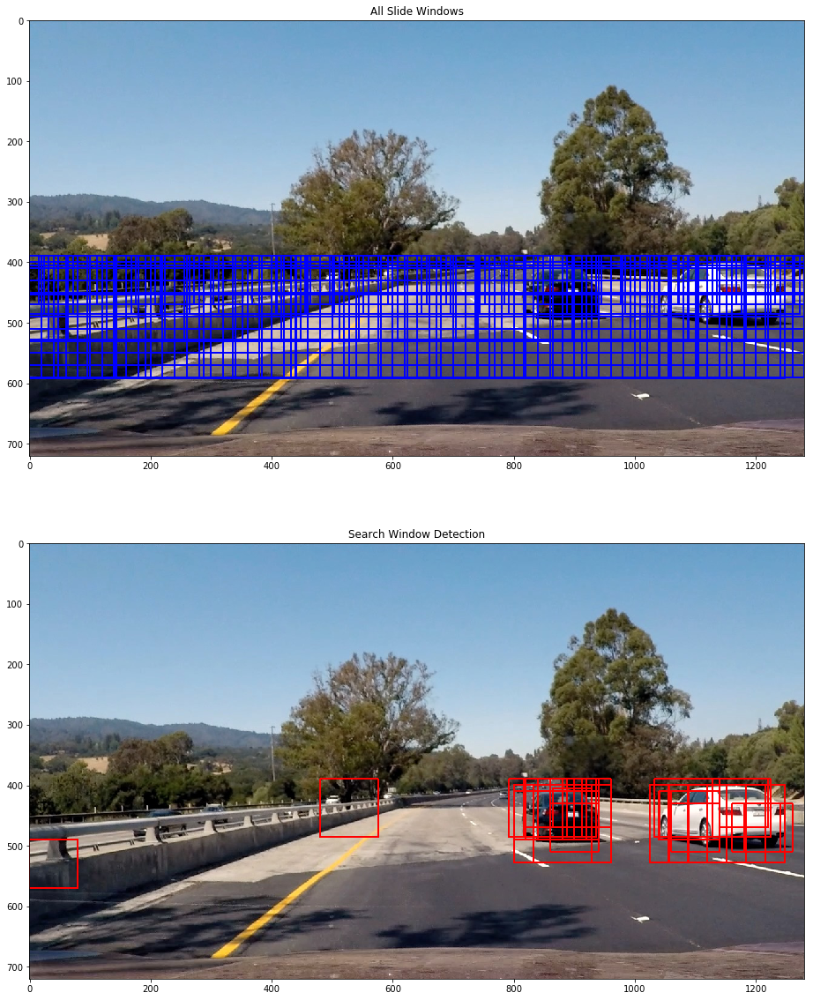

test4.jpg
test_images/test5.jpg


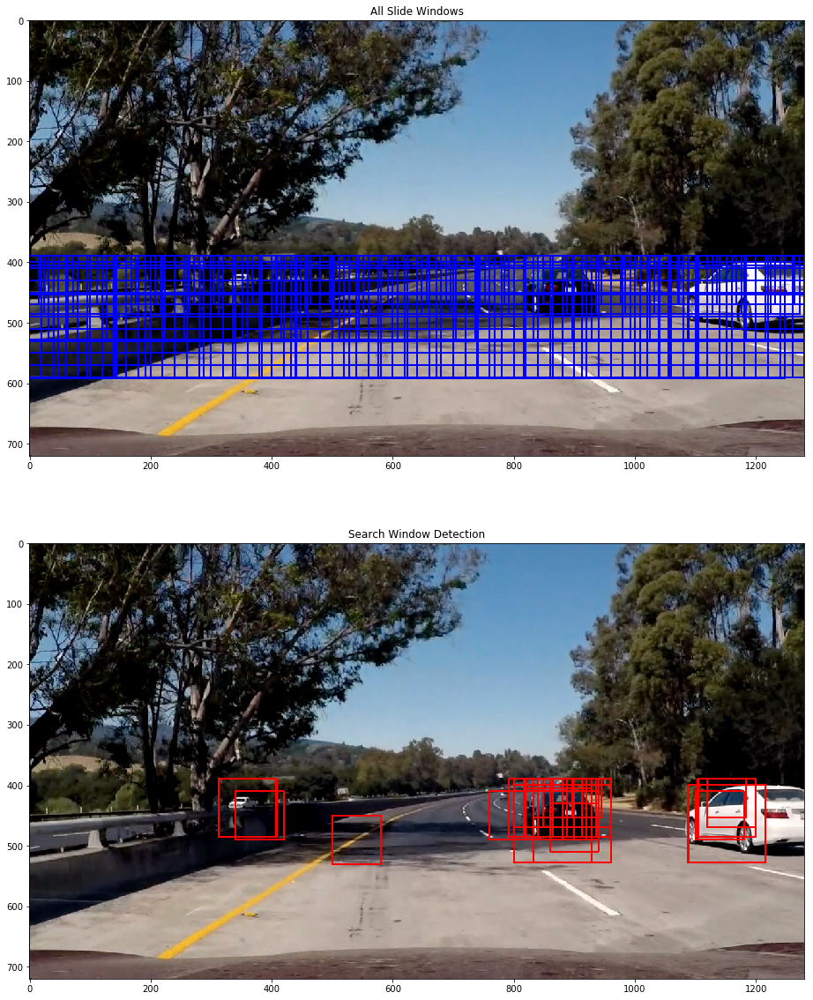

test5.jpg
test_images/test6.jpg


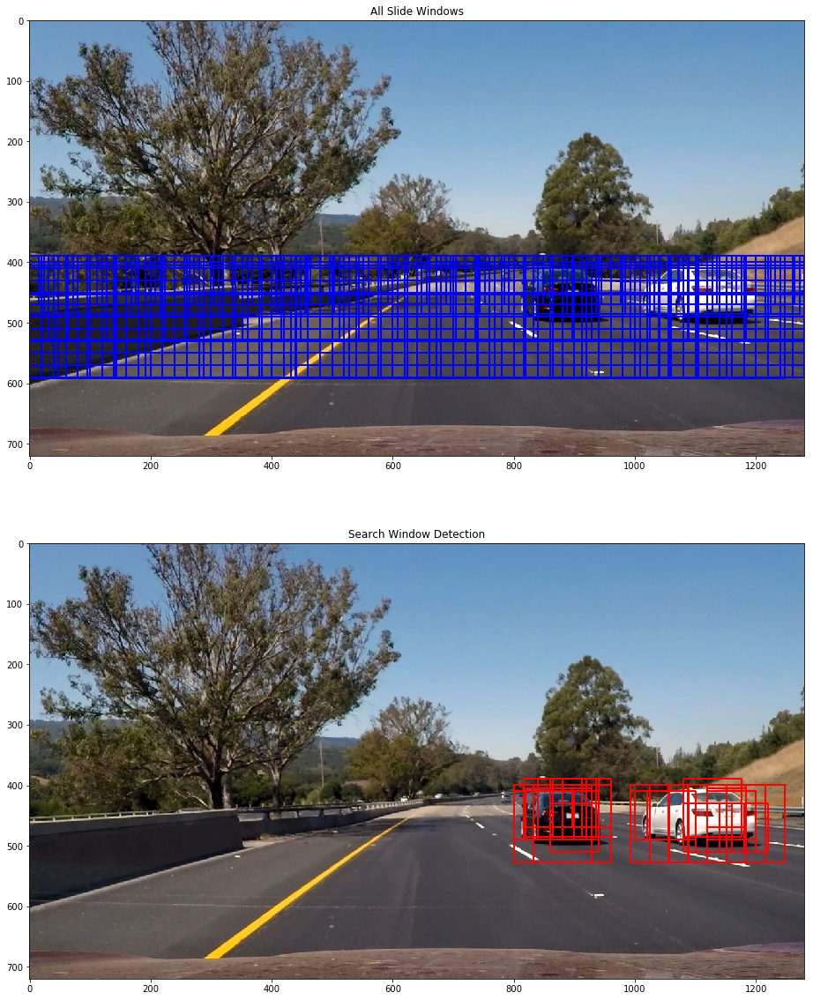

test6.jpg


In [10]:
# Define different window based on how far it is to the camera
window_width =[64,80,96,128,160,192]
y_start_stop_all = [[390,480],[390,600],[390, 500],[400, 530],[400, 550], [400,600]]
x_start_stop=[None, None]
windows =[]
image = mpimg.imread('test_images/test1.jpg')        
for k in range(len(window_width)):
    
    xy_window = (window_width[k],window_width[k])
    y_start_stop = y_start_stop_all[k]
    
    windows += slide_window(image, x_start_stop, y_start_stop,xy_window, xy_overlap=(0.75, 0.75))

for file in glob.glob('test_images/test*.jpg'):
    img = mpimg.imread(file)
    hist_range=(0,256)
    if np.max(img) > 1.05:
        img1 = img.astype(np.float32)/255        
    
    on_windows = search_windows(img1, windows, svc, X_scaler, color_space, spatial_size, hist_bins, 
                        hist_range, orient, pix_per_cell, cell_per_block, hog_channel, 
                        spatial_feat, hist_feat, hog_feat)

    draw_img_1 = draw_boxes(img, windows, color=(0, 0, 255), thick=2)  
    draw_img_2 = draw_boxes(img, on_windows, color=(255, 0, 0), thick=2)  
    
    print(file)
    fig = plt.figure(figsize=(20,20))
    plt.subplot(2,1,1)
    plt.imshow(draw_img_1)
    plt.title('All Slide Windows')
    plt.subplot(2,1,2)
    plt.imshow(draw_img_2)
    plt.title('Search Window Detection')
    plt.show()
    if savefigs is True:
        fname = file.split('/')
        print(fname[1])
        fig.savefig('output_images/test_slide_window_' + fname[1])


## Car Finding with Heat Map

In [11]:
### Codes in this cell are adapted or directly from CarND Class for Vehicle Classifier
# Define a function to draw bounding boxes
# function that adds "heat" to a map for a list of bounding boxes.
def add_heat(heatmap, bbox_list):
    # Iterate through list of bboxes
    for box in bbox_list:
        # Add += 1 for all pixels inside each bbox
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1
    # Return updated heatmap
    return heatmap

# function to threshold the heatmap.
def apply_threshold(heatmap, threshold):
    # Zero out pixels below the threshold
    heatmap[heatmap <= threshold] = 0
    # Return thresholded map
    return heatmap

#  take labels image and put bounding boxes around the labeled regions
def draw_labeled_bboxes(img, labels):
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        # Draw the box on the image
        cv2.rectangle(img, bbox[0], bbox[1], (255,0,0), 6)
    # Return the image
    return img

# define function to find  combined boxes with heat map
from scipy.ndimage.measurements import label

def combine_box_with_heatmap(boxes, image, threshold = 5): 
    heat = np.zeros_like(image[:,:,0]).astype(np.float)
    # Add heat to each box in box list
    heat = add_heat(heat,boxes)
    # Apply threshold to help remove false positives
    heat = apply_threshold(heat,threshold)
    # Visualize the heatmap when displaying    
    heatmap = np.clip(heat, 0, 255)
    # Find final boxes from heatmap using label function
    labels = label(heatmap)
    draw_combined_boxes = draw_labeled_bboxes(np.copy(image), labels)
    return labels, heatmap, draw_combined_boxes
    

## Test  Heat Map 

/home/qliu/anaconda3/lib/python3.6/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


Test image file:  origframes/frame_690_orig.jpg
Number of car boxes:  32
Number of car(s):  2


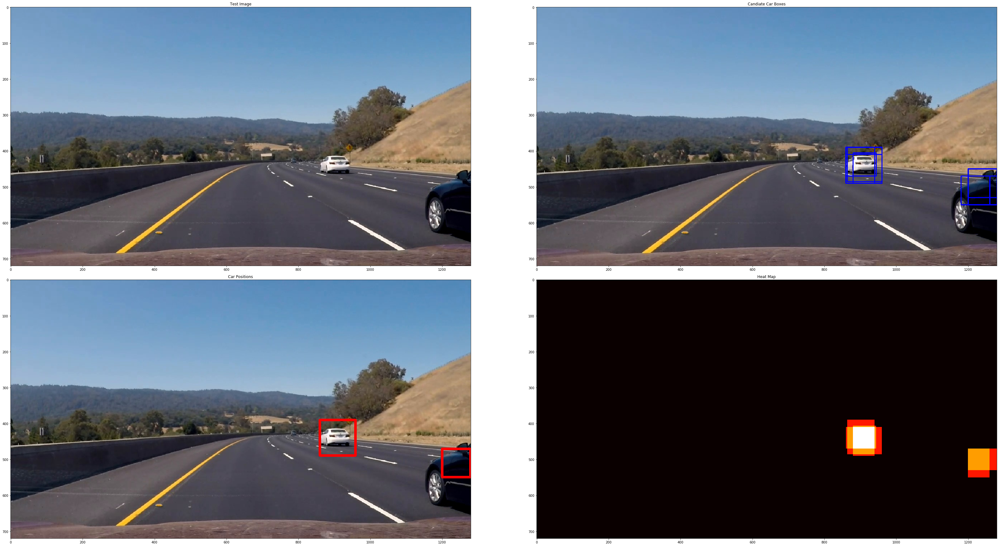

frame_690_orig.jpg
Test image file:  origframes/frame_707_orig.jpg
Number of car boxes:  92
Number of car(s):  2


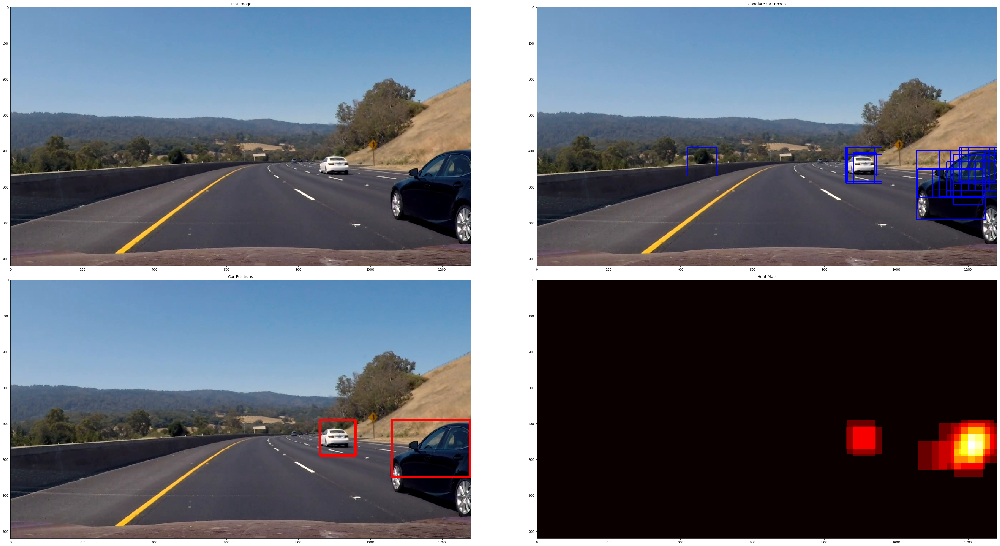

frame_707_orig.jpg
Test image file:  origframes/frame_675_orig.jpg
Number of car boxes:  20
Number of car(s):  1


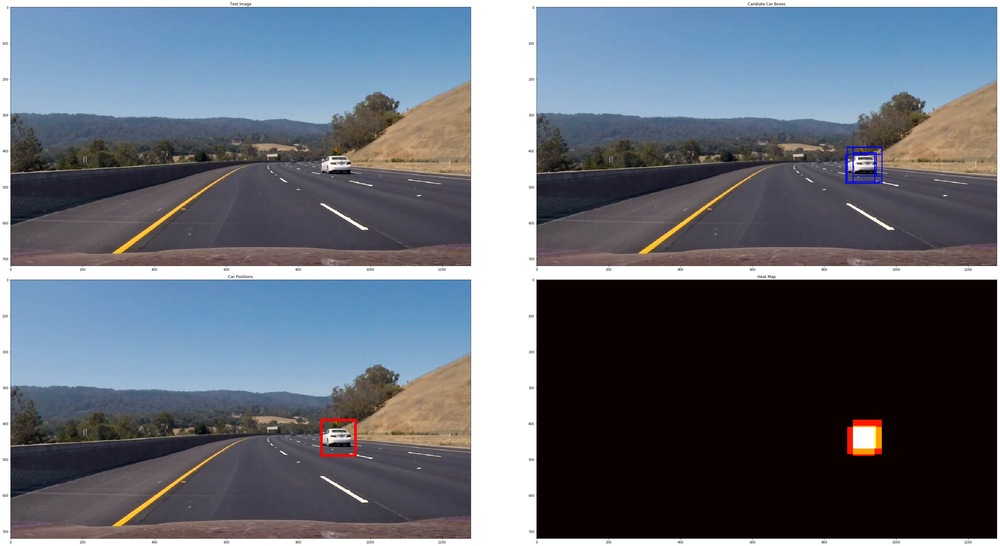

frame_675_orig.jpg
Test image file:  origframes/frame_676_orig.jpg
Number of car boxes:  20
Number of car(s):  1


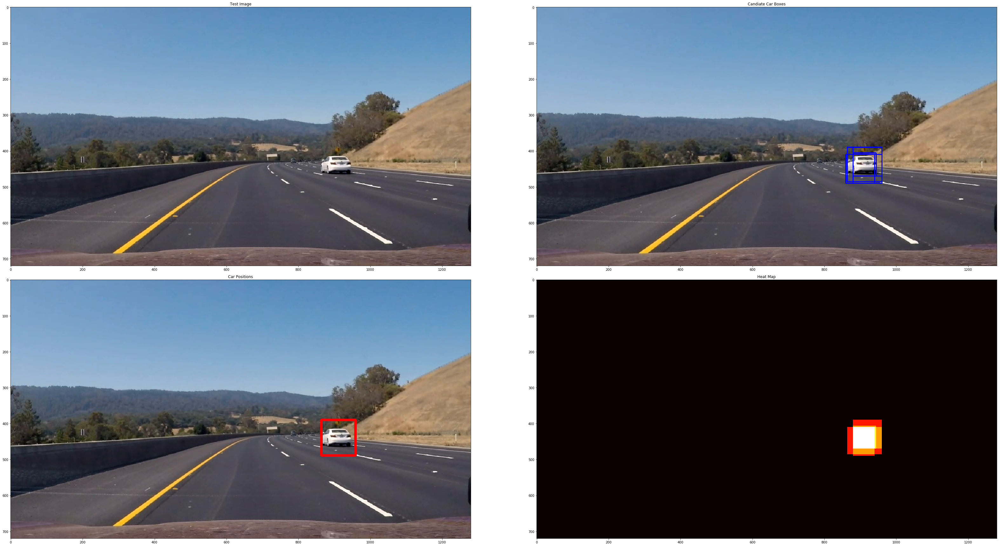

frame_676_orig.jpg
Test image file:  origframes/frame_677_orig.jpg
Number of car boxes:  24
Number of car(s):  1


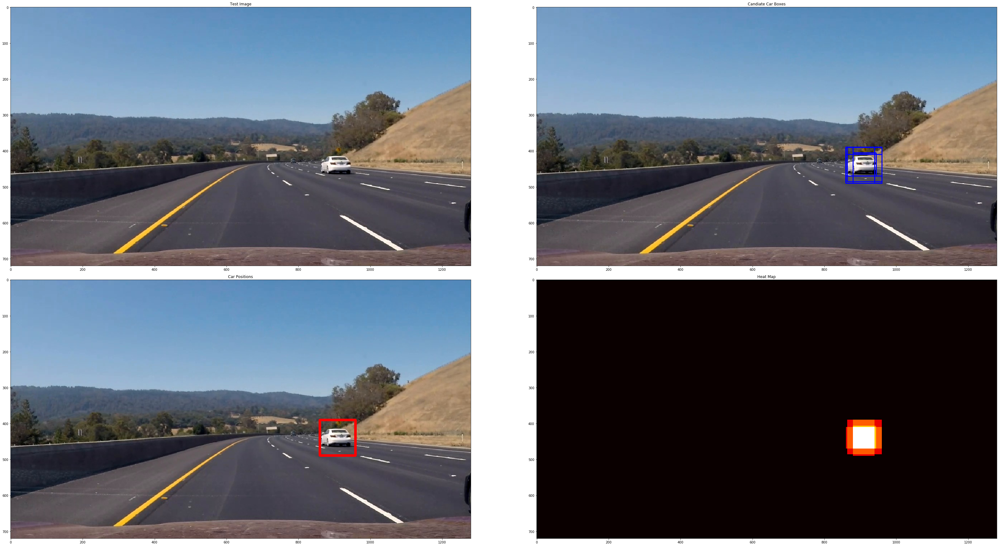

frame_677_orig.jpg
Test image file:  origframes/frame_678_boxes.jpg
Number of car boxes:  28
Number of car(s):  1


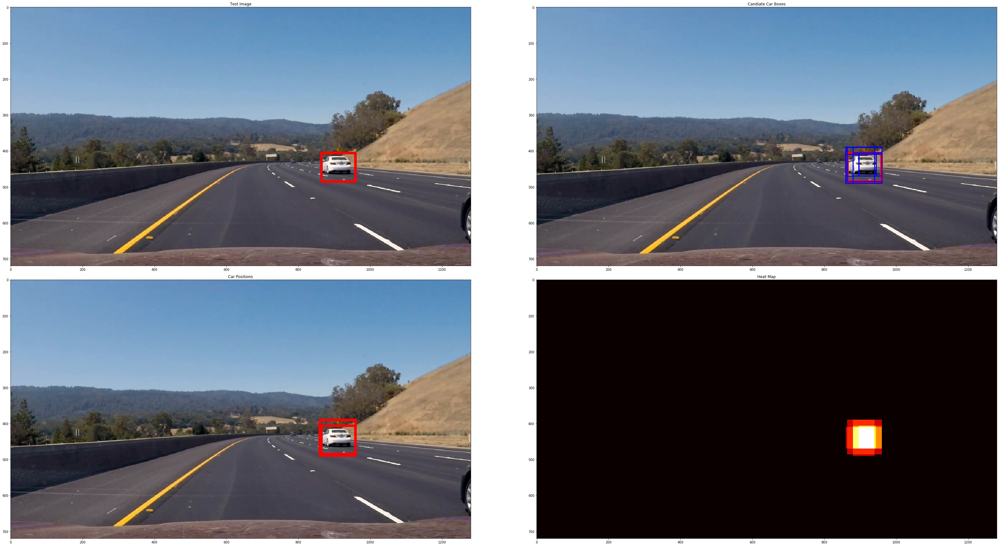

frame_678_boxes.jpg
Test image file:  origframes/frame_679_orig.jpg
Number of car boxes:  20
Number of car(s):  1


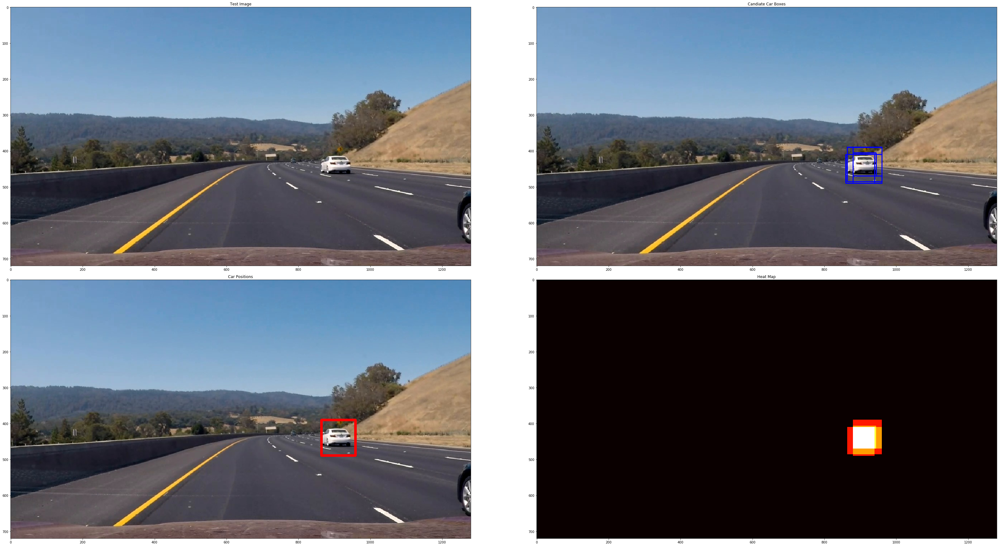

frame_679_orig.jpg
Test image file:  origframes/frame_680_orig.jpg
Number of car boxes:  24
Number of car(s):  1


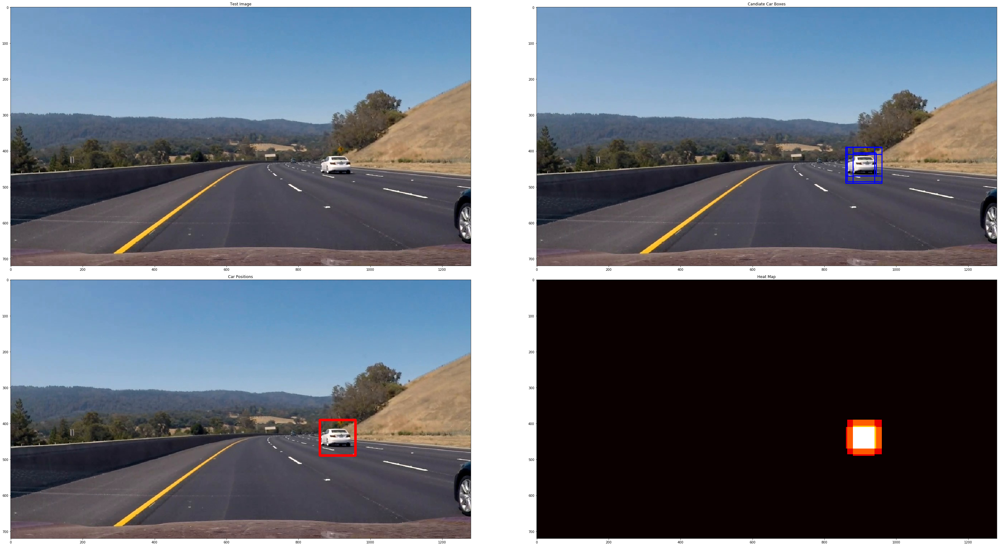

frame_680_orig.jpg
Test image file:  origframes/frame_681_orig.jpg
Number of car boxes:  20
Number of car(s):  1


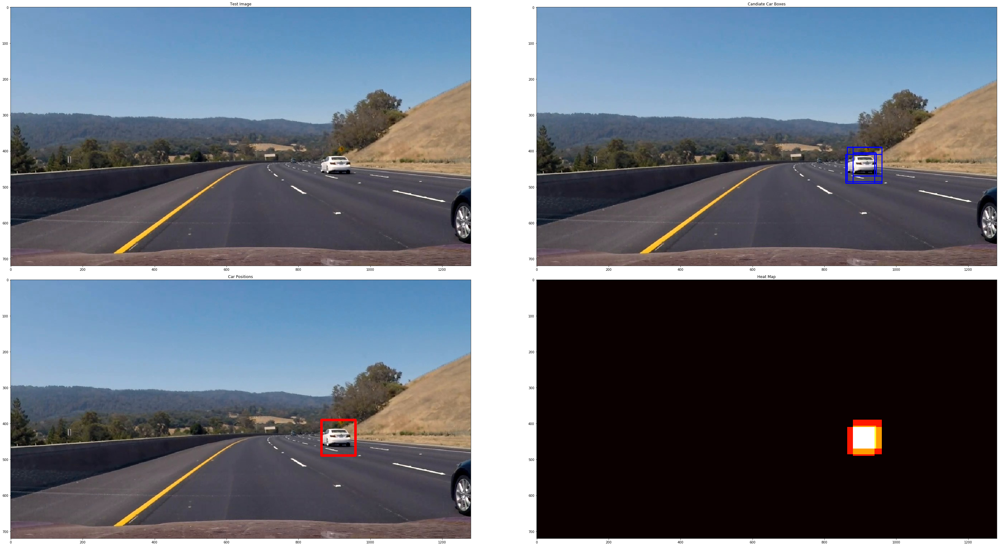

frame_681_orig.jpg
Test image file:  origframes/frame_682_orig.jpg
Number of car boxes:  20
Number of car(s):  1


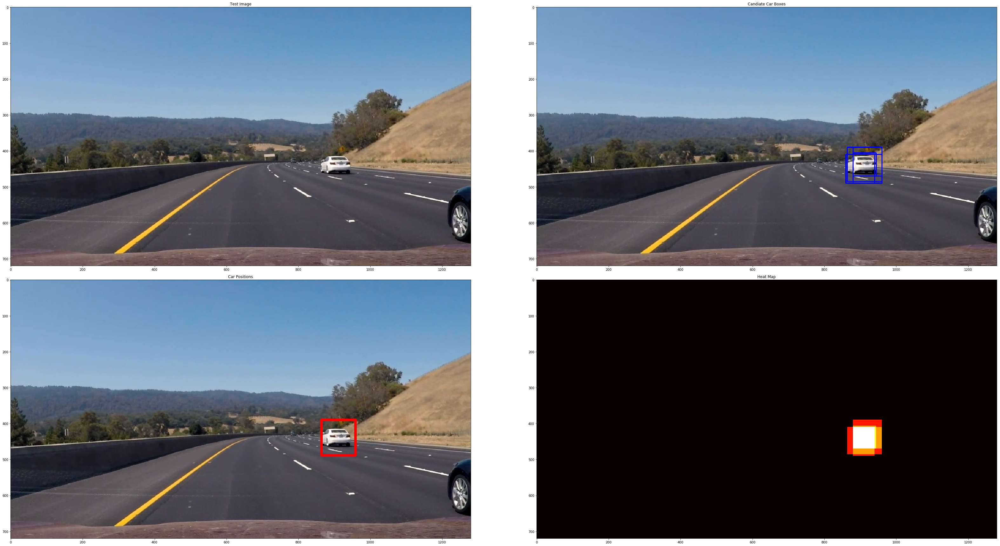

frame_682_orig.jpg
Test image file:  origframes/frame_683_orig.jpg
Number of car boxes:  20
Number of car(s):  1


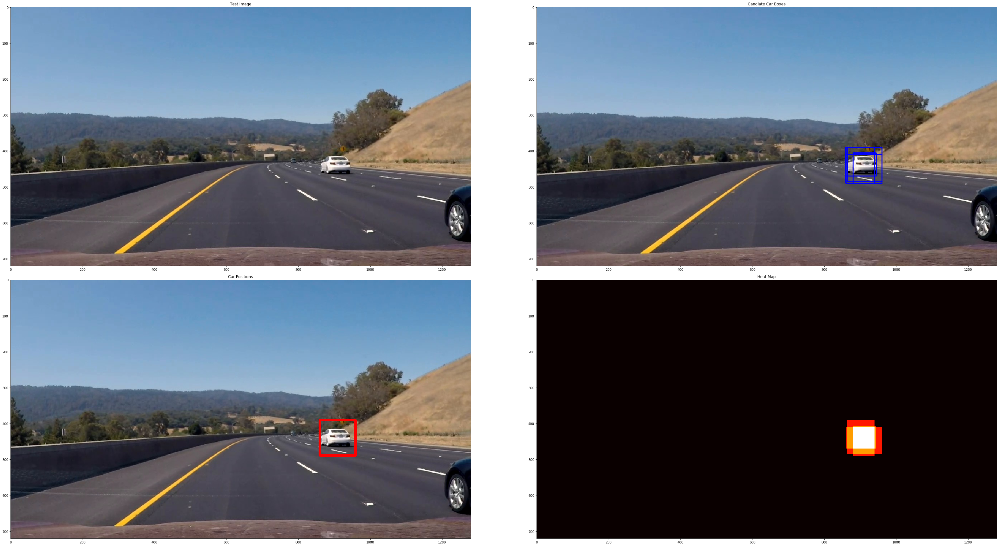

frame_683_orig.jpg
Test image file:  origframes/frame_684_orig.jpg
Number of car boxes:  12
Number of car(s):  1


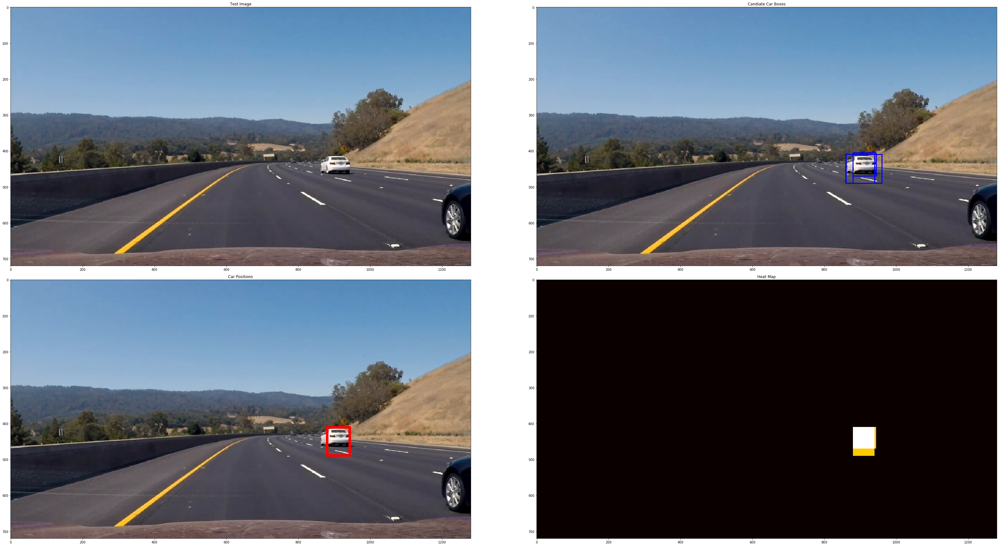

frame_684_orig.jpg
Test image file:  origframes/frame_685_orig.jpg
Number of car boxes:  16
Number of car(s):  1


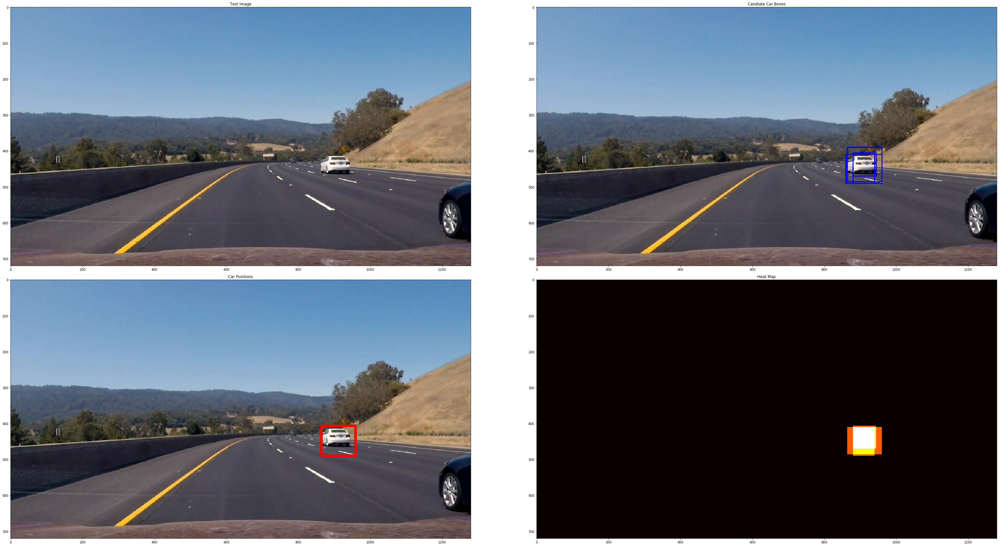

frame_685_orig.jpg
Test image file:  origframes/frame_686_orig.jpg
Number of car boxes:  16
Number of car(s):  1


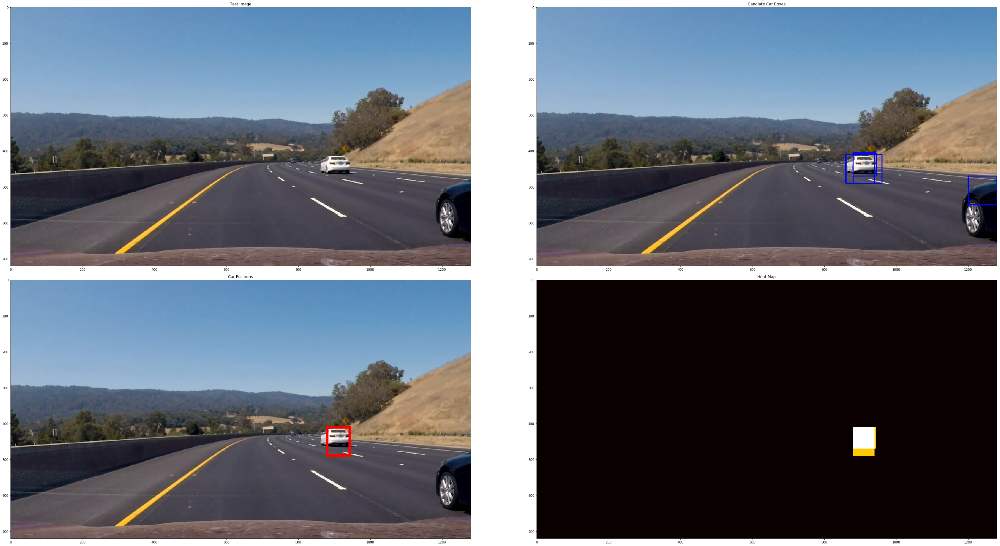

frame_686_orig.jpg
Test image file:  origframes/frame_687_orig.jpg
Number of car boxes:  16
Number of car(s):  1


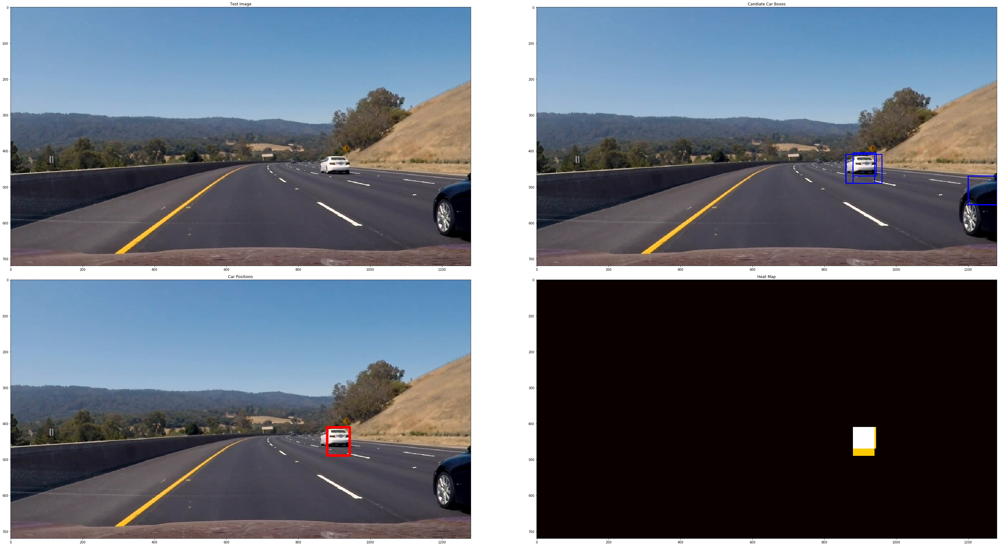

frame_687_orig.jpg
Test image file:  origframes/frame_688_orig.jpg
Number of car boxes:  12
Number of car(s):  1


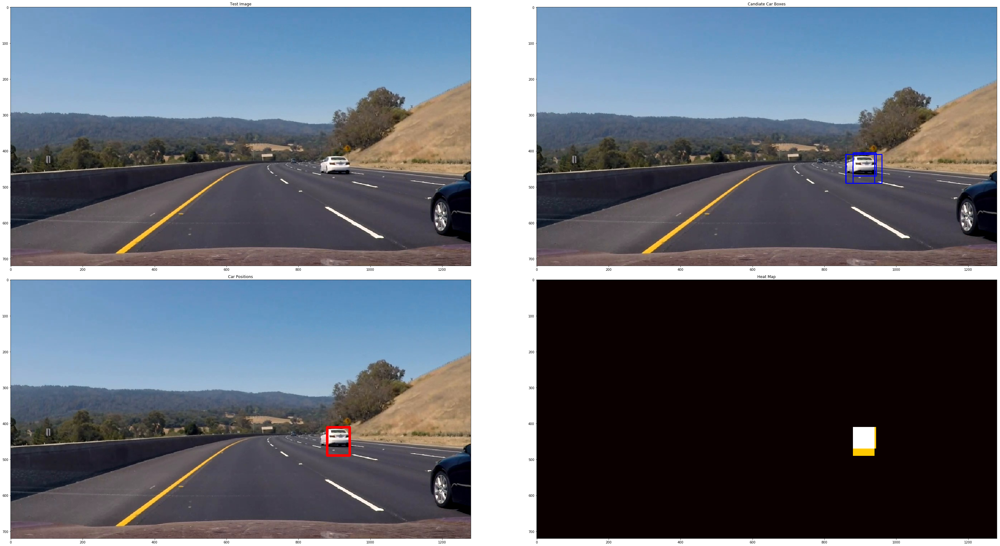

frame_688_orig.jpg
Test image file:  origframes/frame_689_orig.jpg
Number of car boxes:  24
Number of car(s):  2


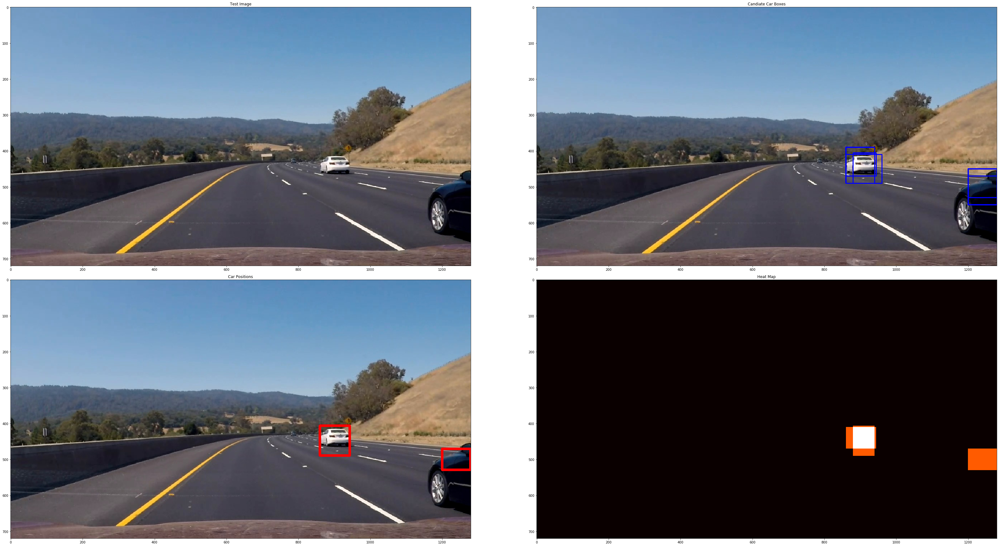

frame_689_orig.jpg
Test image file:  origframes/frame_691_orig.jpg
Number of car boxes:  32
Number of car(s):  2


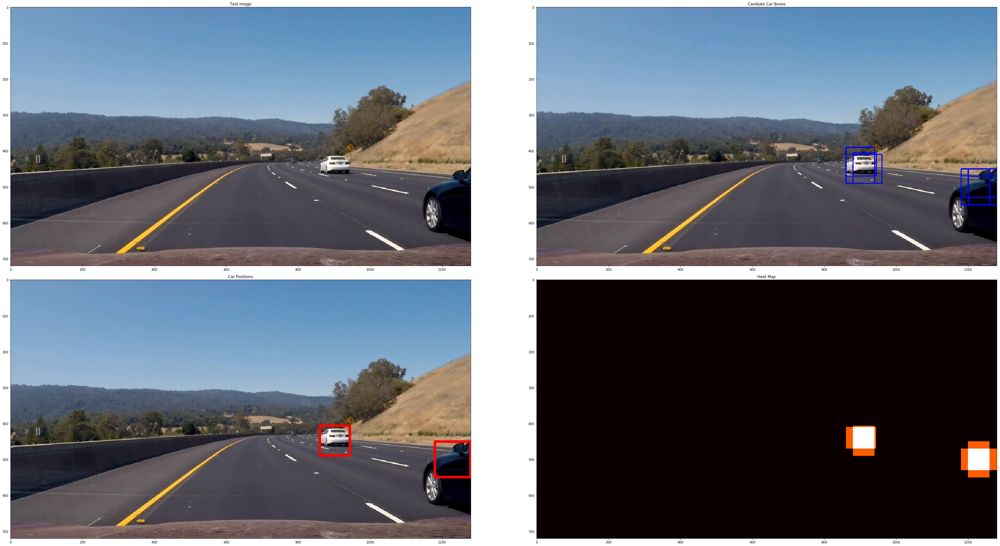

frame_691_orig.jpg


In [ ]:
from scipy.ndimage.measurements import label
x_start_stop=[None, None] 
for k in range(len(window_width)):
    xy_window = (window_width[k],window_width[k])
    y_start_stop = y_start_stop_all[k]
    windows += slide_window(image, x_start_stop, y_start_stop,xy_window, xy_overlap=(0.75, 0.75))
    
for file in glob.glob('origframes/frame*.jpg'):
    image = mpimg.imread(file)
    if np.max(img) > 1.05:
        img1 = image.astype(np.float32)/255     
    hist_range=(0,256)
    boxes  = search_windows(img1, windows, svc, X_scaler, color_space, spatial_size, hist_bins, 
                        hist_range, orient, pix_per_cell, cell_per_block, hog_channel, 
                        spatial_feat, hist_feat, hog_feat)       
    draw_multiple_boxes = draw_boxes(image, boxes, color=(0, 0, 255), thick=2)  
    
    
    labels, heatmap, draw_combined_boxes = combine_box_with_heatmap(boxes, image)

    print('Test image file: ', file)
    print('Number of car boxes: ',len(boxes))
    print('Number of car(s): ',labels[1])
    
    fig=plt.figure(figsize=(48, 24))            
    plt.subplot(221)
    plt.imshow(image)
    plt.title('Test Image')    
    plt.subplot(222)
    plt.imshow(draw_multiple_boxes)
    plt.title('Candiate Car Boxes')
    plt.subplot(223)
    plt.imshow(draw_combined_boxes)
    plt.title('Car Positions')
    plt.subplot(224)
    plt.imshow(heatmap, cmap='hot')
    plt.title('Heat Map')
    fig.tight_layout()
    plt.show()
    
    fname = file.split('/')
    print(fname[1])
    fig.savefig('origframes_output/test_heat_map_' + fname[1])

## Video Implementation 

In [ ]:
# Tracking boxes in continuous frames
## use deque to keep tracking of the heat map, a list-like container with fast appends and pops on either end
from collections import deque
# initialization of the container
heat_list = deque(maxlen =6)
test_project_video=  False 
if savefigs is True:
    frame_list = deque(maxlen =1300)
def vehicle_detection_pipeline(image, video = True):     
    
    if np.max(image) > 1.05:
        img1 = image.astype(np.float32)/255     
   
    hist_range=(0,256)
    # Search boxed for candidate 
    boxes  = search_windows(img1, windows, svc, X_scaler, color_space, spatial_size, hist_bins, 
                        hist_range, orient, pix_per_cell, cell_per_block, hog_channel, 
                        spatial_feat, hist_feat, hog_feat)       
    
    # Add heat to each box in box list
    heat1 = np.zeros_like(image[:,:,0]).astype(np.float)
    heat1 = add_heat(heat1,boxes)
    heatmap1 = np.clip(heat1, 0, 255)
    
        
    heat = heat1      
    threshold = 4
    heat_list.append(heat1) 
    if video is True:  
        if len(heat_list) >=6:
            heat = np.sum(np.array(heat_list), axis=0)   
            threshold = 5
        else:
            if len(heat_list) >=4:
                heat = np.sum(np.array(heat_list), axis=0)   
                threshold =  5           
            else:
                if len(heat_list) >=2:
                    heat = np.sum(np.array(heat_list), axis=0)   
                    threshold =  4               
                else:
                    threshold = 4
           
        
    heat_thresholded = apply_threshold(heat,threshold)
    heatmap = np.clip(heat_thresholded, 0, 255)
          
    # Find final boxes from heatmap using label function
    labels = label(heatmap)   
    draw_combined_boxes = draw_labeled_bboxes(np.copy(image), labels)  
    return draw_combined_boxes

In [ ]:
## Test the pipeline with example images
# initialization of the container
heat_list = deque(maxlen =6)
if savefigs is True:
    frame_list = deque(maxlen =40)   

for file in glob.glob('origframes/frame*.jpg'):
    image = mpimg.imread(file)
    result = vehicle_detection_pipeline(image, video = True)
    fig = plt.figure()
    plt.imshow(result)
    plt.show()